In [2]:
import sys
import gym
import torch
import math
import pylab
import random
import numpy as np
from collections import deque
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.autograd import Variable
from torchvision import transforms
%matplotlib inline

In [3]:
# Hyper Parameters
BATCH_SIZE = 64
LR = 0.001                   # learning rate
EPSILON = 0.9               # greedy policy
GAMMA = 0.9                 # reward discount
TARGET_REPLACE_ITER = 100   # target update frequency
MEMORY_CAPACITY = 2000
# env = gym.make('Pendulum-v0')
# env = env.unwrapped
# N_ACTIONS = 25
# ACTION_SPACE = 25
# N_STATES = env.observation_space.shape[0]
env = gym.make('CartPole-v0')
env = env.unwrapped
N_ACTIONS = env.action_space.n
N_STATES = env.observation_space.shape[0]

tmpSize = torch.rand(BATCH_SIZE, 2)

WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.


In [4]:
class Net(nn.Module):
    def __init__(self, ):
        super(Net, self).__init__()
        self.fc1 = nn.Linear(N_STATES, 10)
        self.fc1.weight.data.normal_(0, 0.1)   # initialization
        self.out = nn.Linear(10, 1)
        self.out.weight.data.normal_(0, 0.1)   # initialization

        #注意out输出的形式size
        #注意out2相当于原来的Q(s,a;θ)
        self.fc2 = nn.Linear(N_STATES,10)
        self.fc2.weight.data.normal_(0,0.1)
        self.out2 = nn.Linear(10,N_ACTIONS)
        self.out2.weight.data.normal_(0,0.1)

    def forward(self, x):
        x1 = self.fc1(x)
        x1 = F.relu(x1)

        x2 = self.fc1(x)
        x2 = F.relu(x2)

        y1 = self.out(x1)
        y2 = self.out2(x2)
        #y1是size=1*1的期望  y2是size=10*1  
        #状态的所有动作Q期望  + action-value的优势程度(思考优势程度的定义)
#         print("y1size",y1.size())
#         print("y2size",y2.size())
        x3 = y1.expand_as(y2) 
#         print("x3size",x3.size())
#         print(y2.mean(dim=1,keepdim=True).size())
#         print("y2.mean(1)size",y2.mean(1).view(64,-1).size())
        tmp = y2
        x3 += (y2 - y2.mean(dim=1,keepdim=True).expand_as(tmp))
#         print("x3size",x3.size())
        actions_value = x3
        return actions_value

In [5]:
#矩阵维度问题
#y2是一维行向量  求取列方向dim=1均值后 再扩展为原来形式
#out[i][j][k] dim=0选择i  dim=1选择j  dim=2选择k
test_mean = [1,1,4]
test_mean = torch.tensor(test_mean, dtype=torch.float).view(1,-1)
tmp = test_mean
print (test_mean)
print(test_mean.mean(1))
#下面两种expand方式等价
print(test_mean.mean(1).expand_as(tmp))
print(test_mean.mean(1).expand(tmp.size()))
print(tmp.size())

ar = torch.rand(64, 1)
print(ar.size())

tensor([[1., 1., 4.]])
tensor([2.])
tensor([[2., 2., 2.]])
tensor([[2., 2., 2.]])
torch.Size([1, 3])
torch.Size([64, 1])


In [6]:
USE_GPU = True

torch.cuda.set_device(3)
# dtype = torch.cuda.FloatTensor # we will be using float throughout this tutorial

if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

print('using device:', device)
print(torch.cuda.current_device())

using device: cuda
3


In [7]:
class Agent(object):
    def __init__(self, **kwargs):
        for key, value in kwargs.items():
            setattr(self, key, value)
        self.eval_net = Net().to(device)
        self.optimizer = optim.Adam(self.eval_net.parameters(), lr=self.lr)
        self.buffer = []
        self.steps = 0
        self.loss_fn = nn.MSELoss()
        
    def act(self, s0):
        self.steps += 1
        epsi = self.epsi_low + (self.epsi_high-self.epsi_low) * (math.exp(-1.0 * self.steps/self.decay))
        if random.random() < epsi:
            a0 = random.randrange(self.action_space_dim)
        else:
            s0 =  torch.tensor(s0, dtype=torch.float,device=device).view(1,-1)
            a0 = torch.argmax(self.eval_net(s0)).item()
        return a0

    def put(self, *transition):
        if len( self.buffer)==self.capacity:
            self.buffer.pop(0)
        self.buffer.append(transition)
        
    def learn(self):
        if (len(self.buffer)) < self.batch_size:
            return
        
        samples = random.sample( self.buffer, self.batch_size)
        
        s0, a0, r1, s1 = zip(*samples)

        s0 = torch.tensor( s0, dtype=torch.float,device=device)
        a0 = torch.tensor( a0, dtype=torch.long,device=device).view(self.batch_size, -1)
        r1 = torch.tensor( r1, dtype=torch.float,device=device).view(self.batch_size, -1)
        s1 = torch.tensor( s1, dtype=torch.float,device=device)
        
        
#         print("      ",self.gamma * torch.max( self.eval_net(s1).detach(), dim=1)[0].size())
        
        
        y_true = r1 + self.gamma * torch.max( self.eval_net(s1).detach(), dim=1)[0].view(self.batch_size, -1)
        y_pred = self.eval_net(s0).gather(1, a0)
        
#         print( y_pred)
#         print(y_true)
        
        
        loss = self.loss_fn(y_pred, y_true)
        
        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()
        
    def plot(self, score, mean):
        from IPython import display
        import matplotlib.pyplot as plt
        display.clear_output(wait=True)
        display.display(plt.gcf())
        plt.figure(figsize=(20,10))
        plt.clf()
    
        plt.title('Training...')
        plt.xlabel('Episode')
        plt.ylabel('Duration')
        plt.plot(score)
        plt.plot(mean)
        plt.text(len(score)-1, score[-1], str(score[-1]))
        plt.text(len(mean)-1, mean[-1], str(mean[-1]))

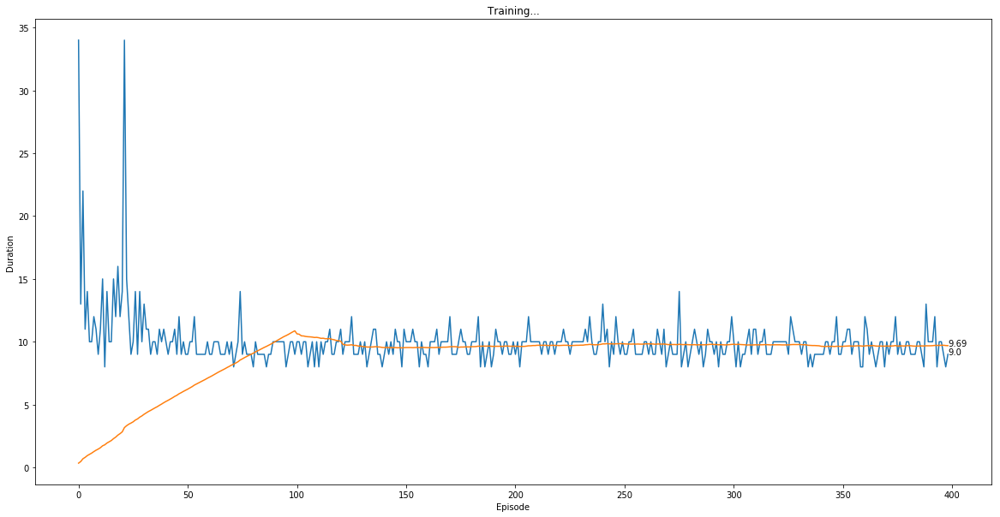

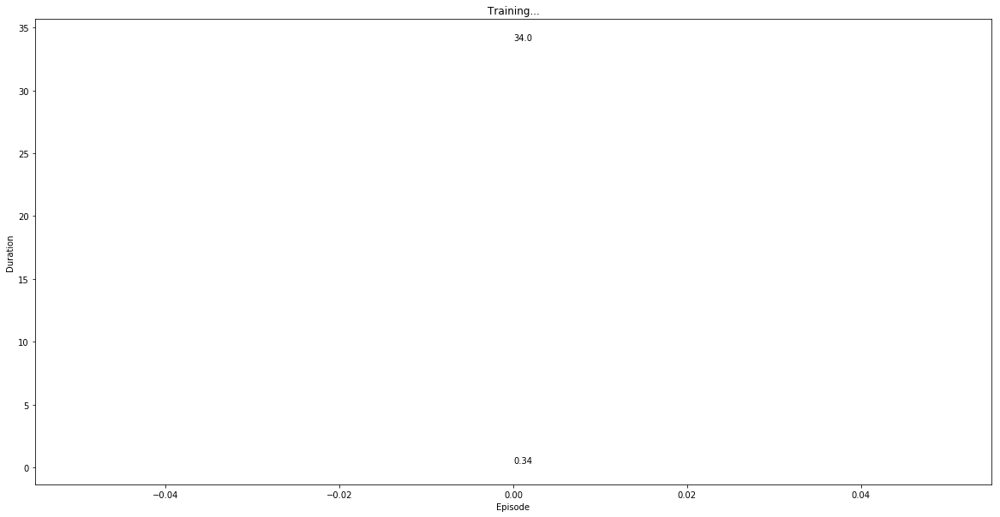

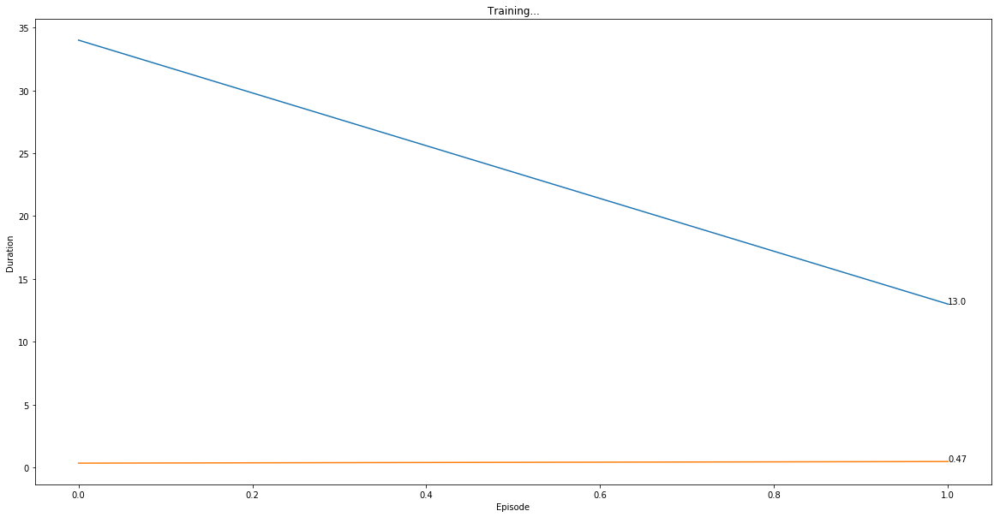

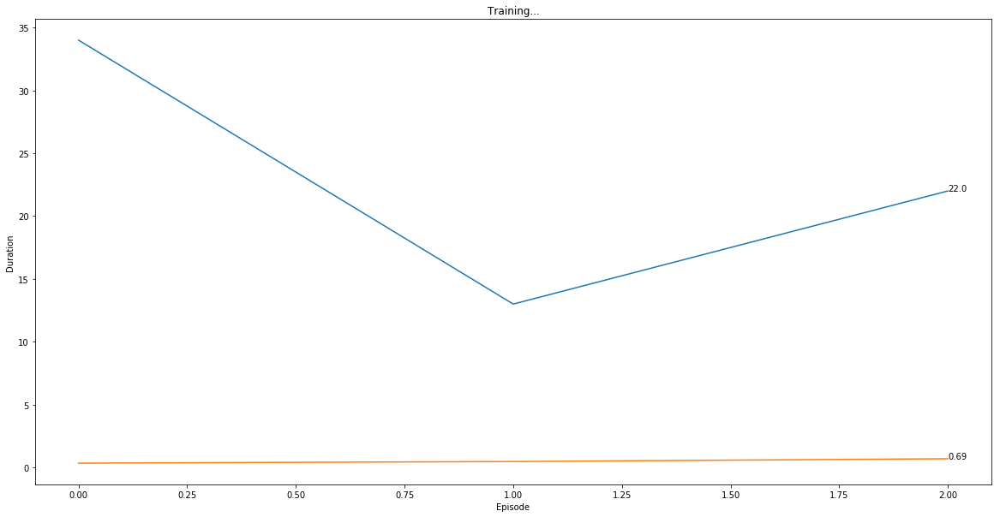

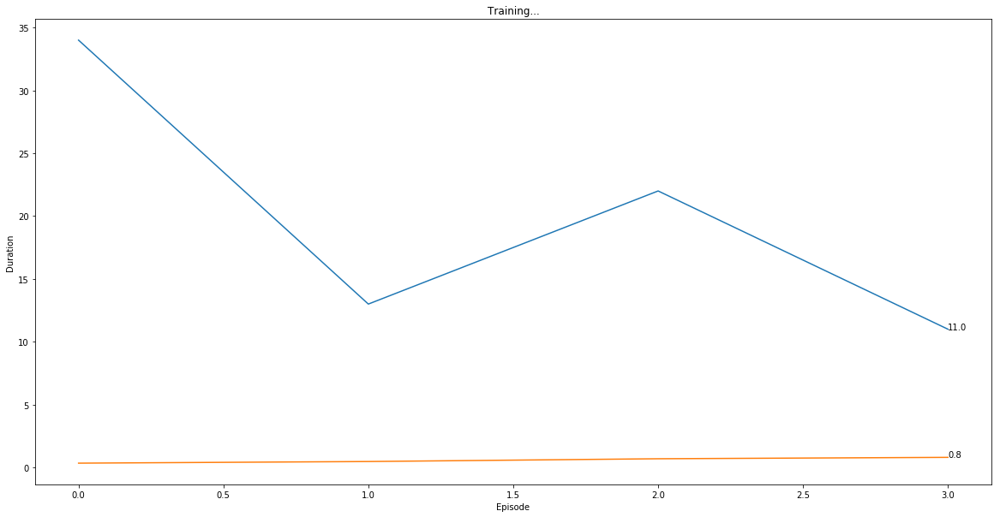

...

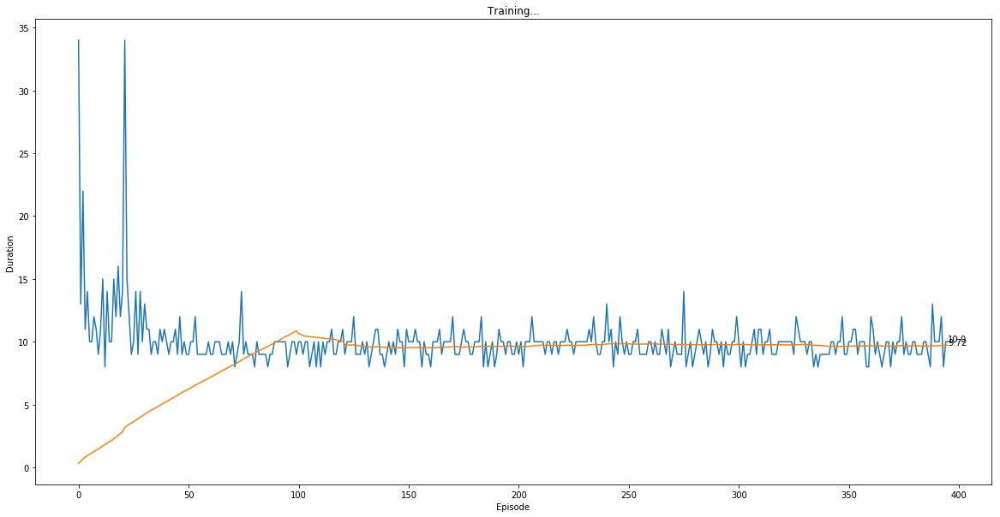

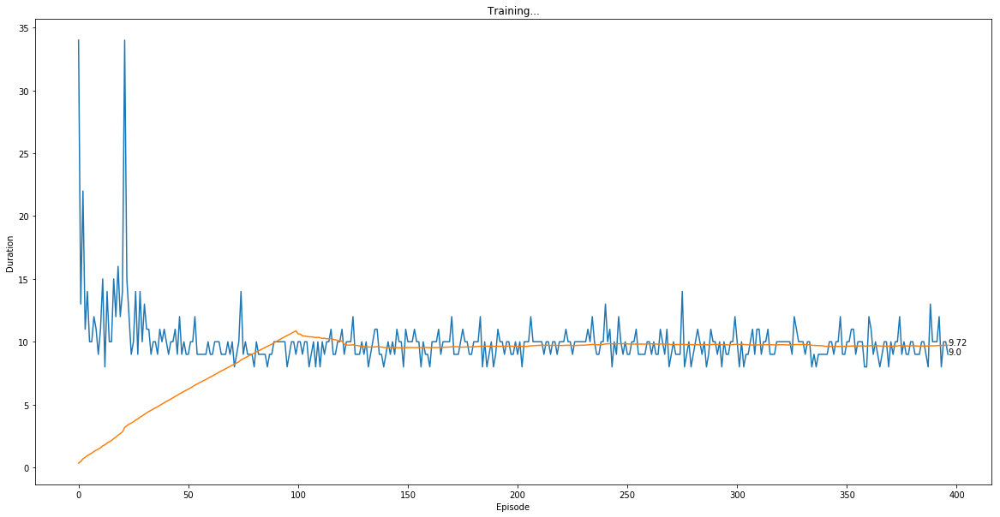

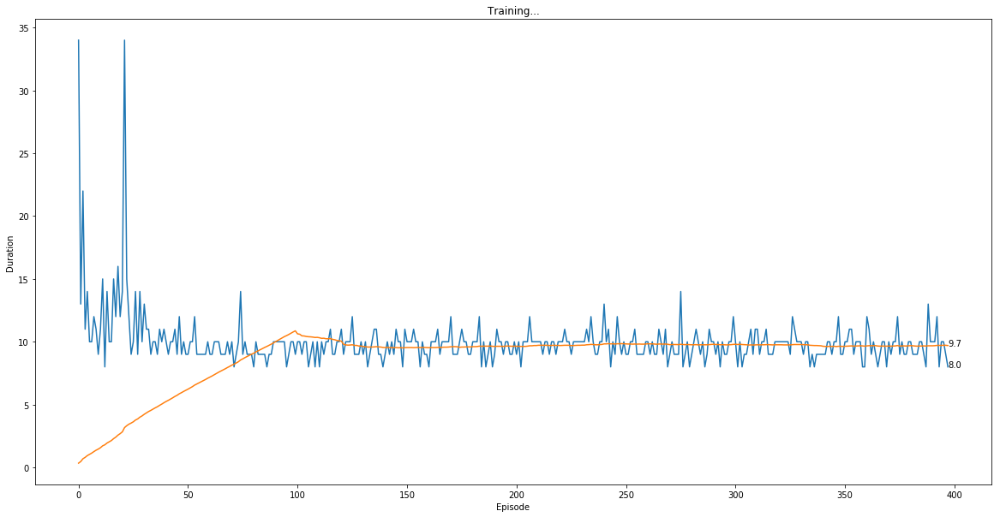

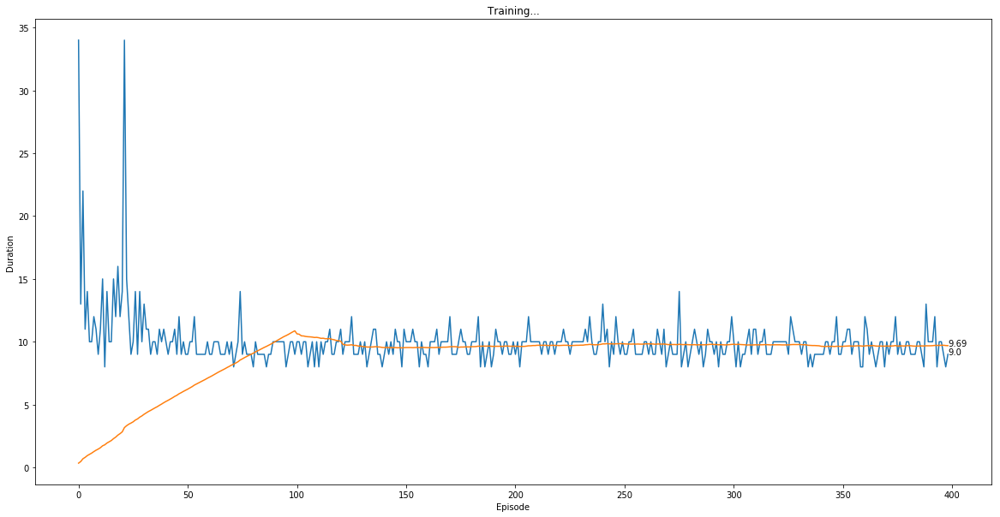

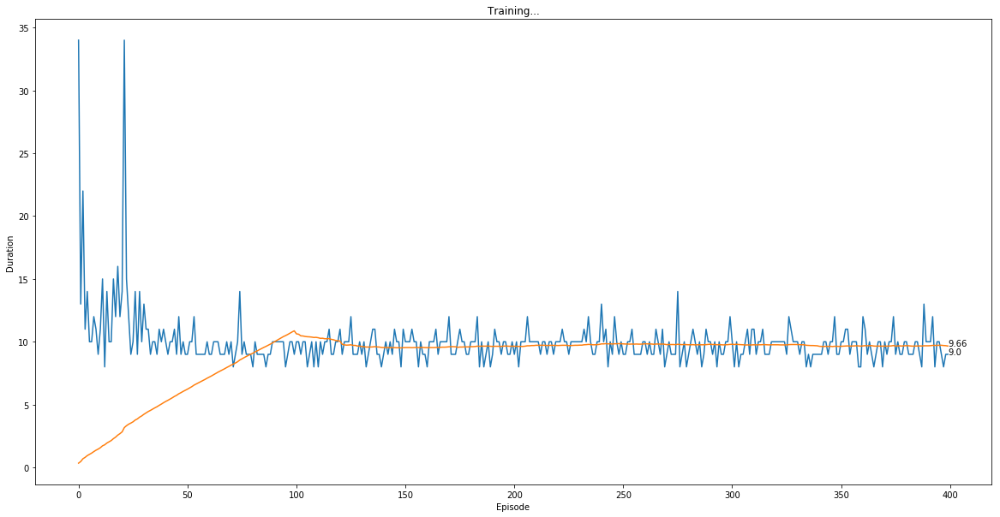

In [8]:

# # Hyper Parameters
# BATCH_SIZE = 32
# LR = 0.001                   # learning rate
# EPSILON = 0.9               # greedy policy
# GAMMA = 0.9                 # reward discount
# TARGET_REPLACE_ITER = 100   # target update frequency
# MEMORY_CAPACITY = 2000
# # env = gym.make('Pendulum-v0')
# # env = env.unwrapped
# # N_ACTIONS = 25
# # ACTION_SPACE = 25
# # N_STATES = env.observation_space.shape[0]
# env = gym.make('CartPole-v0')
# env = env.unwrapped
# N_ACTIONS = env.action_space.n
# N_STATES = env.observation_space.shape[0]

env = gym.make('CartPole-v0')
params = {
    'gamma': 0.8,
    'epsi_high': 0.9,
    'epsi_low': 0.05,
    'decay': 200, 
    'lr': 0.001,
    'capacity': 10000,
    'batch_size': 64,
    'state_space_dim': env.observation_space.shape[0],
    'action_space_dim': env.action_space.n   
}
agent = Agent(**params)

score = []
mean = []

for episode in range(400):
    s0 = env.reset()
    total_reward = 1
    while True:
        env.render()
        a0 = agent.act(s0)
        s1, r1, done, _ = env.step(a0)
        
        if done:
            r1 = -1
            
        agent.put(s0, a0, r1, s1)#加入到memory中
        
        if done:
            break

        total_reward += r1
        s0 = s1
        agent.learn() #minibatch训练NN
    
    #一轮模拟结束
    score.append(total_reward)
    mean.append( sum(score[-100:])/100)
    agent.plot(score, mean)